In [14]:
from google.colab import files
files.upload()

Saving blue.tif to blue (2).tif
Saving green.tif to green (2).tif
Saving nir.tif to nir (2).tif
Saving red edge.tif to red edge (2).tif
Saving red.tif to red (2).tif


{'blue (2).tif': b'II*\x00\x08\x00\x00\x00\x11\x00\x00\x01\x03\x00\x01\x00\x00\x00\xe8\x03\x00\x00\x01\x01\x03\x00\x01\x00\x00\x00\xe8\x03\x00\x00\x02\x01\x03\x00\x02\x00\x00\x00\x10\x00\x10\x00\x03\x01\x03\x00\x01\x00\x00\x00\x05\x00\x00\x00\x06\x01\x03\x00\x01\x00\x00\x00\x01\x00\x00\x00\x11\x01\x04\x00\xe8\x03\x00\x00\xaa\x08\x00\x00\x15\x01\x03\x00\x01\x00\x00\x00\x02\x00\x00\x00\x16\x01\x03\x00\x01\x00\x00\x00\x01\x00\x00\x00\x17\x01\x03\x00\xe8\x03\x00\x00\xda\x00\x00\x00\x1c\x01\x03\x00\x01\x00\x00\x00\x01\x00\x00\x00=\x01\x03\x00\x01\x00\x00\x00\x01\x00\x00\x00R\x01\x03\x00\x01\x00\x00\x00\x00\x00\x00\x00S\x01\x03\x00\x02\x00\x00\x00\x01\x00\x01\x00\x0e\x83\x0c\x00\x03\x00\x00\x00J\x18\x00\x00\x82\x84\x0c\x00\x06\x00\x00\x00b\x18\x00\x00\xaf\x87\x03\x00 \x00\x00\x00\x92\x18\x00\x00\xb1\x87\x02\x00\x1e\x00\x00\x00\xd2\x18\x00\x00\x00\x00\x00\x00"\x0b\x1a\x0b#\x0b\xfe\n\x14\x0b \x0b\x04\x0b\x0b\x0b\x13\x0b\xf5\n\xff\n\xf3\n\x02\x0b\n\x0b\x04\x0b\xf2\n\x07\x0b\x17\x0b\x14\x0b\xfe\

In [8]:
!pip install rasterio scikit-image

In [15]:
import numpy as np
import rasterio
from skimage import filters, morphology, exposure

# -------------------------------------------------
# 1. FILENAMES (exact Colab names)
# -------------------------------------------------
FILES = {
    'red': 'red (2).tif',
    'green': 'green (2).tif',
    'blue': 'blue (2).tif',
    'nir': 'nir (2).tif',
    'red_edge': 'red edge (2).tif'
}

# -------------------------------------------------
# 2. LOAD BAND USING RASTERIO
# -------------------------------------------------
def load_band(path):
    with rasterio.open(path) as src:
        data = src.read(1).astype(np.float32)

        # Replace NoData with 0
        if src.nodata is not None:
            data[data == src.nodata] = 0

        # Normalize
        return data / (np.max(data) + 1e-6)

# -------------------------------------------------
# 3. MAIN FUNCTION
# -------------------------------------------------
def calculate_weed_matrix():
    print("--- Starting Weed Detection ---")

    bands = {}

    # Load all bands
    for key, fname in FILES.items():
        try:
            bands[key] = load_band(fname)
            print(f"✓ Loaded {fname} | shape={bands[key].shape}")
        except Exception as e:
            print(f"✗ Failed to load {fname}: {e}")
            return None

    # -------------------------------------------------
    # 4. VEGETATION INDICES
    # -------------------------------------------------
    wsri = (bands['red_edge'] - bands['red']) / (
        bands['red_edge'] - bands['blue'] + 1e-6
    )

    ndre = (bands['nir'] - bands['red_edge']) / (
        bands['nir'] + bands['red_edge'] + 1e-6
    )

    ndvi = (bands['nir'] - bands['red']) / (
        bands['nir'] + bands['red'] + 1e-6
    )

    # -------------------------------------------------
    # 5. VEGETATION MASK
    # -------------------------------------------------
    veg_thresh = filters.threshold_otsu(ndvi)
    veg_mask = ndvi > veg_thresh

    if np.sum(veg_mask) == 0:
        print("⚠ No vegetation detected")
        return []

    # -------------------------------------------------
    # 6. WEED SCORE
    # -------------------------------------------------
    weed_score = (wsri * 0.7) + (ndre * 0.3)
    weed_score = np.where(veg_mask, weed_score, 0)

    # -------------------------------------------------
    # 7. THRESHOLD + CLEANUP
    # -------------------------------------------------
    threshold = np.percentile(weed_score[veg_mask], 85)
    weed_mask = (weed_score > threshold) & veg_mask

    weed_mask = morphology.binary_opening(
        weed_mask, morphology.disk(1)
    )

    # -------------------------------------------------
    # 8. EXTRACT MATRIX [row, col, intensity]
    # -------------------------------------------------
    coords = np.argwhere(weed_mask)

    intensity_map = exposure.rescale_intensity(
        weed_score * weed_mask, out_range=(0, 1)
    )

    matrix = []
    for r, c in coords:
        intensity = float(intensity_map[r, c])
        if intensity > 0.1:
            matrix.append([int(r), int(c), round(intensity, 4)])

    return matrix

# -------------------------------------------------
# 9. RUN
# -------------------------------------------------
result = calculate_weed_matrix()

if result:
    print("\n--- RESULT ---")
    print("Total weeds detected:", len(result))
    print("First 10 rows:")
    for row in result[:10]:
        print(row)

    with open("weed_detection_matrix.txt", "w") as f:
        f.write(str(result))

    print("\n✓ Saved weed_detection_matrix.txt")
else:
    print("No weeds detected.")

--- Starting Weed Detection ---
✓ Loaded red (2).tif | shape=(1000, 1000)
✓ Loaded green (2).tif | shape=(1000, 1000)
✓ Loaded blue (2).tif | shape=(1000, 1000)
✓ Loaded nir (2).tif | shape=(1000, 1000)
✓ Loaded red edge (2).tif | shape=(1000, 1000)

--- RESULT ---
Total weeds detected: 9
First 10 rows:
[413, 634, 1.0]
[533, 342, 0.1256]
[547, 714, 0.1648]
[552, 733, 0.5516]
[702, 993, 0.6267]
[763, 988, 0.1572]
[807, 192, 0.3418]
[865, 995, 0.1407]
[897, 697, 0.1169]

✓ Saved weed_detection_matrix.txt


--- Preparing Visualization ---


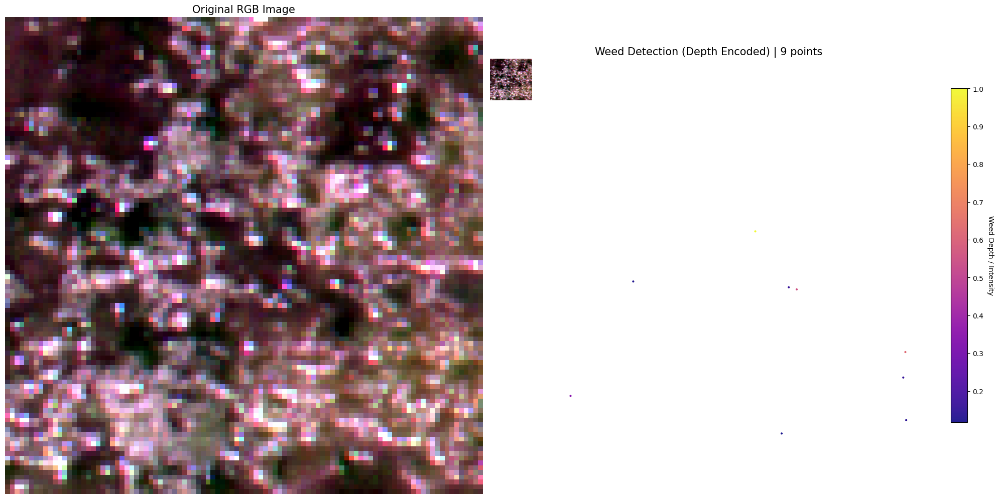

In [16]:
import numpy as np
import matplotlib.pyplot as plt
import rasterio

def visualize_results(matrix_result):
    print("--- Preparing Visualization ---")

    # -------------------------------------------------
    # 1. LOAD RGB BANDS SAFELY (GeoTIFF)
    # -------------------------------------------------
    try:
        with rasterio.open('red (1).tif') as src:
            r = src.read(1).astype(np.float32)
        with rasterio.open('green (1).tif') as src:
            g = src.read(1).astype(np.float32)
        with rasterio.open('blue (1).tif') as src:
            b = src.read(1).astype(np.float32)
    except Exception as e:
        print(f"Error loading RGB bands: {e}")
        return

    # -------------------------------------------------
    # 2. RGB COMPOSITE + CONTRAST STRETCH
    # -------------------------------------------------
    rgb = np.stack([r, g, b], axis=-1)

    p2, p98 = np.percentile(rgb, (2, 98))
    rgb = np.clip(rgb, p2, p98)
    rgb = (rgb - p2) / (p98 - p2 + 1e-6)

    # -------------------------------------------------
    # 3. EXTRACT WEED POINTS
    # -------------------------------------------------
    if not matrix_result:
        print("No weeds detected.")
        return

    rows = np.array([pt[0] for pt in matrix_result])
    cols = np.array([pt[1] for pt in matrix_result])
    intensities = np.array([pt[2] for pt in matrix_result])  # 0 → 1

    # Normalize intensities for colormap
    intensities = np.clip(intensities, 0, 1)

    # -------------------------------------------------
    # 4. PLOT
    # -------------------------------------------------
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))

    # Left: Original RGB
    ax[0].imshow(rgb)
    ax[0].set_title("Original RGB Image", fontsize=15)
    ax[0].axis('off')

    # Right: RGB + Weed Points (depth-based color)
    sc = ax[1].imshow(rgb)
    points = ax[1].scatter(
        cols,
        rows,
        c=intensities,        # depth controls color
        cmap='plasma',          # light → dark red
        s=4,                  # point size
        alpha=0.9
    )

    ax[1].set_title(f"Weed Detection (Depth Encoded) | {len(rows)} points", fontsize=15)
    ax[1].axis('off')

    # Colorbar
    cbar = plt.colorbar(points, ax=ax[1], fraction=0.035)
    cbar.set_label("Weed Depth / Intensity", rotation=270, labelpad=15)

    plt.tight_layout()
    plt.show()

# -------------------------------------------------
# RUN VISUALIZATION
# -------------------------------------------------
visualize_results(result)